In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
import sys
import os
from datetime import datetime

import scipy.stats as st

from sklearn.metrics import mean_absolute_error as MAE
from sklearn import linear_model

import seaborn as sns
from plotly.subplots import make_subplots
import plotly.graph_objects as go
from plotly.offline import plot

import json
sys.path.insert(1, '../')
import lib.pe_down_loading_data_frame as loader
import lib.pe_utils as utils
import lib.pe_model as model
import lib.pe_config as conf
import lib.pe_df_analyzer as analyzer
import lib.pe_varmaker as va_m
import lib.pe_df_writer as writer
import lib.pe_metrics as metrics
import lib.pe_preprocessing as prepro


import lib.la_model as la_model

import imp

import json
sys.path.insert(1, '../')
import lib.pe_down_loading_data_frame as loader
imp.reload(loader)
import lib.pe_utils as utils
imp.reload(utils)
import lib.pe_model as model
imp.reload(model)
import lib.pe_config as conf
imp.reload(conf)
import lib.pe_df_analyzer as analyzer
imp.reload(analyzer)
import lib.pe_varmaker as va_m
imp.reload(va_m)
import lib.pe_df_writer as writer
imp.reload(writer)
import lib.pe_metrics as metrics
imp.reload(metrics)
import lib.pe_preprocessing as prepro
imp.reload(prepro)
import lib.la_prepro as la_prepro
imp.reload(la_prepro)
import lib.la_utils as la_utils
imp.reload(la_utils)
load_model_data = utils.load_model_data
load_var_data  = utils.load_var_data
'''
import lib.pe_df_reader as reader
'''

'\nimport lib.pe_df_reader as reader\n'

In [2]:
dots = 5
two_week = 60 * 24 * 7 * 2
get_var = True
step = '1m'
start_date = '06/05/2020 00:01'
end_date = '13/05/2020 00:01'

dc_period = {'au2-acs1': [start_date, end_date],
             'us6-acs2': [start_date, end_date],
             'eu3-acs1': [start_date, end_date],
             'us3': [start_date, end_date],
            }

folder = '06.05.2020_13.05.2020'

# dc_period = {'au2-acs1': ['01/04/2020 00:01', '06/05/2020 00:01'],
#              'us6-acs2': ['01/04/2020 00:01', '06/05/2020 00:01'],
#              'eu3-acs1': ['01/04/2020 00:01', '06/05/2020 00:01'],
#              'us3': ['01/04/2020 00:01', '06/05/2020 00:01'],
#             }
folder = '01.04.2020_06.05.2020'



# Если хочешь взглянуть на уже обработанные данные, то просто загрузи 

## Loading results 

In [3]:
for_heat_map_duration = pd.read_csv('../datasets/'+folder+'/heat_map_duartion.csv', header = None, index_col = 0, names = list(range(1,31)))
for_heat_map_number = pd.read_csv('../datasets/'+folder+'/heat_map_nubmer.csv', header = None, index_col = 0, names = list(range(1,31)))
for_result = pd.read_csv('../datasets/'+folder+'/for_result.csv',index_col = 0 )

dc_reslut = json.load( open( "../datasets/"+folder+"/anomaly_and_sigma.json" ) )
dict_dc_inst_anomalies = json.load( open( "../datasets/"+folder+"/dict_dc_inst_anomalies.json" ) )
dict_dc_inst_anomalies_coeff = json.load( open( "../datasets/"+folder+"/dict_dc_inst_anomalies_coeff.json" ) )
anomalies_dict_for_dcs = json.load( open( "../datasets/"+folder+"/anomalies_dict_for_dcs.json" ) )
dict_dc_inst_metric = json.load( open( "../datasets/"+folder+"/dict_dc_inst_metric.json" ) )

# Иначе обработай новые данные) 

# Скачаем данные 

In [4]:
for dc in dc_period:
    for inst_num in conf.get_inst_range_for_dc(dc):
        start_time = dc_period[dc][0]
        end_time = dc_period[dc][1]
        
        load_model_data(dc, inst_num, start_time, end_time, dots)
        load_var_data(dc, inst_num, start_time, end_time, dots)


model:
DC=au2-acs1
INSTANCE=1


KeyboardInterrupt: 

# Применим старую модель к новым данным

In [4]:
def percentile(df, p, t, numbers_1):
    summ = df[df['time_stamp'].isin([t])]['summ']
    summ_delay = 0
    for i, delay in enumerate(numbers_1):
        summ_delay += df[df['time_stamp'].isin([t])][df.columns[i+1]]
        if summ_delay.values[0] > summ.values[0]*p/100:
            return numbers_1[i]

In [6]:
import pickle

train_size = 60 * 24 * 7 * 2

old_model_start_date = '01/04/2020 00:01'
old_model_end_date = '06/05/2020 00:01'

norm_old_model_start_date = ''.join(''.join(''.join(old_model_start_date.split('/')).split(' ')).split(':'))
norm_old_model_end_date = ''.join(''.join(''.join(old_model_end_date.split('/')).split(' ')).split(':'))

old_model_folder = '01.04.2020_06.05.2020'

dict_dc_inst_metric = {}
for dc in dc_period: 
    dict_dc = {}
    for inst_num in conf.get_inst_range_for_dc(dc):
        coeff_df = pd.DataFrame()
        instance = utils.get_instance_for_dc(dc, inst_num)
        print(f'\nDC = {dc}\nINSTANCE = {instance}')
        start_time = dc_period[dc][0]
        end_time = dc_period[dc][1]
        
        st_time = start_time.replace(" ", "").replace("/", "").replace(":", "")
        en_time = end_time.replace(" ", "").replace("/", "").replace(":", "")
        
        out_file_name = 'for_plot/'
        out_file_name += utils.get_file_name(kind=f'simpleLR__train={train_size}__dots={dots}',
                                            dc=dc, inst_num=inst_num, st_time=st_time, en_time=en_time, 
                                            dots=dots)
        
        old_model = '../datasets/for_fitted_model/' + 'simpleLR__train=20160__dots=5__'+dc+'__'+str(inst_num)+'__'+norm_old_model_start_date+'__'+norm_old_model_end_date+'__5.sav'
        
        if not os.path.isfile(f'../datasets/{out_file_name}.csv'):
            # we already got fine model
            
            data_file_name = load_model_data(dc, inst_num, st_time, en_time, dots, pri=False)

            # and data
            data = pd.read_csv(data_file_name)
            data = la_prepro.fill_misses(data)
            
            predictor = pickle.load(open(old_model, 'rb'))
        
            out = predictor.predict(data)
            out.dropna(inplace=True)
            
            coeff_df['coef'] = predictor.est.coef_
            coeff_df.index = predictor.features
            min_v = 0
            coeff_df = coeff_df[coeff_df['coef'] > min_v].sort_values('coef', ascending=False)
            main_metrics = []
            for metric in coeff_df.index.tolist():
                if not metric[-1] in [str(i) for i in list(range(1,10))]:
                    main_metrics.append(metric)    
                else:
                    if not metric[:-3] in main_metrics:
                        main_metrics.append(metric[:-3])
            main_metrics.remove('target')
            main_metrics = main_metrics[:5]
            dict_dc[inst_num] = main_metrics
            
            # for division by number of requests - 1 cell 
            #data['number_of_process'] = data[data.columns[1]].diff()
            
            out['predictions'] = predictor.scaler_y.inverse_transform(out['predictions_sc'].values.reshape(-1, 1))
            out['target_der'] = predictor.scaler_y.inverse_transform(out['target_der_sc'].values.reshape(-1, 1))
            
            y_hat = predictor.scaler_y.inverse_transform(out['predictions_sc'].values.reshape((-1, 1)))
            y = predictor.scaler_y.inverse_transform(out['target_der_sc'].values.reshape((-1, 1)))
            out['main_error'] = metrics.relative_mae(y, y_hat, abs_val=True, vectorize=True)
            
            # for division by number of requests - 2 cells
            #ts_out = set(out['time_stamp'].values.tolist())
            #out['main_error']= out['main_error']/data['number_of_process'][data['time_stamp'].isin(ts_out)]
            
            # for division by number of requests - 3 cells
            #out.dropna(inplace=True)
            #out.replace([np.inf, -np.inf], np.nan, inplace = True)
            #out.dropna(inplace=True)
            
            integrated = utils.get_inegral(init=out['target'].values[0], 
                                           values=out['predictions'].values)[1:]
            out['predicted_target'] = integrated
            # data with variance
            if get_var:
                bucket_query = 'abgw_iop_latency_ms_bucket{dc="' + dc + '"' + ', err="OK", iop="isync", instance="' 
                bucket_query += instance + '", proxied = "0"}'
                metric_start = "abgw_iop_latency_ms_bucket_dc=" + dc + "_err=OK_instance=" + instance
                metric_start += "_iop=isync_job=abgw_le="
                var_file_name = load_var_data(dc, inst_num, st_time, en_time, dots, pri=False)
                df_var = va_m.var_maker(start_time, end_time, bucket_query, metric_start, data_path=var_file_name)
                out = pd.merge(out, df_var[['time_stamp', 'variance', 'mean']], how='outer', on='time_stamp')
            # ну а теперь пожалуй сохраним данные для отчётности
            writer.write_df(df=out, file_name=out_file_name)
        else:
            print('model was already applied for this dc and inst')
        # теперь обрабатываем и выявляем аномалии
    dict_dc_inst_metric[dc] = dict_dc


DC = au2-acs1
INSTANCE = au2-acs1-stor01.vstoragedomain
model was already applied for this dc and inst

DC = au2-acs1
INSTANCE = au2-acs1-stor02.vstoragedomain
model was already applied for this dc and inst

DC = au2-acs1
INSTANCE = au2-acs1-stor03.vstoragedomain
model was already applied for this dc and inst

DC = au2-acs1
INSTANCE = au2-acs1-stor04.vstoragedomain
model was already applied for this dc and inst

DC = au2-acs1
INSTANCE = au2-acs1-stor05.vstoragedomain
model was already applied for this dc and inst

DC = au2-acs1
INSTANCE = au2-acs1-stor06.vstoragedomain
model was already applied for this dc and inst

DC = au2-acs1
INSTANCE = au2-acs1-stor07.vstoragedomain
model was already applied for this dc and inst

DC = au2-acs1
INSTANCE = au2-acs1-stor08.vstoragedomain
model was already applied for this dc and inst

DC = au2-acs1
INSTANCE = au2-acs1-stor09.vstoragedomain
model was already applied for this dc and inst

DC = au2-acs1
INSTANCE = au2-acs1-stor10.vstoragedomain
model w

In [76]:
# dict_dc_inst_metric = {}
# for dc in dc_period: 
#     dict_dc = {}
#     for inst_num in conf.get_inst_range_for_dc(dc):
#         coeff_df = pd.DataFrame()
#         instance = utils.get_instance_for_dc(dc, inst_num)
#         print(f'\nDC = {dc}\nINSTANCE = {instance}')
#         start_time = dc_period[dc][0]
#         end_time = dc_period[dc][1]
        
#         st_time = start_time.replace(" ", "").replace("/", "").replace(":", "")
#         en_time = end_time.replace(" ", "").replace("/", "").replace(":", "")
        
#         out_file_name = 'for_plot/'
#         out_file_name += utils.get_file_name(kind=f'simpleLR__train={train_size}__dots={dots}',
#                                             dc=dc, inst_num=inst_num, st_time=st_time, en_time=en_time, 
#                                             dots=dots)
        
            
#         data_file_name = load_model_data(dc, inst_num, st_time, en_time, dots, pri=False)

#         # and data
#         data = pd.read_csv(data_file_name)
#         data = la_prepro.fill_misses(data)
#         train_data = data[:train_size]
#         print(f'train_data.shape={train_data.shape}')

#         predictor = model.Model1_Scaled_Derive(dots=dots)
#         predictor.fit(train_data)   


#         coeff_df['coef'] = predictor.est.coef_
#         coeff_df.index = predictor.features
#         min_v = 0
#         coeff_df = coeff_df[coeff_df['coef'] > min_v].sort_values('coef', ascending=False)
#         main_metrics = []
#         for metric in coeff_df.index.tolist():
#             if not metric[-1] in [str(i) for i in list(range(1,10))]:
#                 main_metrics.append(metric)    
#             else:
#                 if not metric[:-3] in main_metrics:
#                     main_metrics.append(metric[:-3])
#         main_metrics.remove('target')
#         main_metrics = main_metrics[:5]
#         dict_dc[inst_num] = main_metrics
#     dict_dc_inst_metric[dc] = dict_dc

In [9]:
path = '../datasets/for_plot/'

norm_start_date = ''.join(''.join(''.join(start_date.split('/')).split(' ')).split(':'))
norm_end_date = ''.join(''.join(''.join(end_date.split('/')).split(' ')).split(':'))

dc_file = {}
for r, d, f in os.walk(path):
    for file in f:
        f_s = str(file).split('__')
        if f_s[0] == 'simpleLR' and f_s[2] == 'dots=5' and f_s[7] == '5.csv' and f_s[5] == norm_start_date and f_s[6] == norm_end_date :
            # if there is a novel dc
            if f_s[3] not in dc_file:
                dc_file[f_s[3]] = [file]
            # add a file name
            else:
                dc_file[f_s[3]].append(file)          

In [7]:
dc_reslut = json.load( open( "../datasets/"+old_model_folder+"/anomaly_and_sigma.json" ) )
dict_dc_inst_metric = json.load( open( "../datasets/"+folder+"/dict_dc_inst_metric.json" ) )

In [10]:
dcs = list(dc_file.keys())

# Подведём какие-то итоги 

In [13]:
def results(dcs, dc_result):
    
    path = '../datasets/for_plot/'
    html_path = '../datasets/plots/'
    
    for_heat_map_duration = pd.DataFrame(np.zeros((4, 30)),index = ['eu3-acs1',
                                       'us6-acs2',
                                       'au2-acs1',
                                        'us3'
                                      ], columns = [i for i in range(1,31)])

    for_heat_map_number = pd.DataFrame(np.zeros((4, 30)),
                                   index = ['eu3-acs1',
                                            'us6-acs2',
                                            'au2-acs1', 'us3'
                                            ],
                                   columns = [i for i in range(1,31)]
                                  )

    for_result = pd.DataFrame(index = ['eu3-acs1',
                                    'us6-acs2',
                                    'au2-acs1', 'us3'
                                      ],
                          columns = ['Number of sigmas',
                                     'Number of anomalies',
                                     'Expected number of anomalies',
                                     'Amount of anomaly-time']
                         )
    dict_dc_inst_anomalies = {}
    dict_dc_inst_anomalies_coeff = {}
    anomalies_dict_for_dcs = {}
    
    for dc in dc_result:
        dict_dc = {}
        dict_dc_coeff = {}
        anomalies_dict_for_dc = {}
        number_of_all_anomalies = 0
        n_s = dc_reslut[dc][0]
        inst_and_duration_anomalies = {}
        inst_and_number_anomalies = {}
        all_duration = 0
        
        for file in sorted(dc_file[dc]):
            duration = 0
            f_s = str(file).split('__')
            inst_n = int(f_s[4])
            dc = f_s[3]
            
            # getting data and adding a column with date
            plot_data = pd.read_csv(path + file).dropna()
            reloads_ts = plot_data[plot_data['target_der'] < 0]['time_stamp'].values
            plot_data = analyzer.get_df_with_no_reloads(plot_data, reloads_ts, 'predicted_target')
            plot_data = analyzer.get_df_with_no_reloads(plot_data, reloads_ts, 'target')  
            plot_data = analyzer.get_df_with_droped_reloads(plot_data, reloads_ts, reload_window=60 * 10)
            
            list_of_anomalys = analyzer.find_interval_of_anomaly_with_mode(plot_data, n_s,
                                                                           'and of mean and main_error')
            
            anomalies_dict_for_dc[inst_n] = list_of_anomalys
        
            if list_of_anomalys:
                anomaly_duration = [(list_of_anomalys[i][1]-list_of_anomalys[i][0])/60 for i in range(len(list_of_anomalys))]
                list_of_anomalys = [list_of_anomalys[i] for i in range(len(list_of_anomalys)) if anomaly_duration[i] >= 5 ]
                if list_of_anomalys:
                    anomaly_duration = [(list_of_anomalys[i][1]-list_of_anomalys[i][0])/60 for i in range(len(list_of_anomalys))]
                    dict_dc[inst_n] = list_of_anomalys
                    print(f'dc = {dc}')
                    print(f'inst_n = {inst_n}; anomalies: {list_of_anomalys}')
                    both_coeff = []
                    for mode in ['mean', 'main_error']:
                        s, mu = analyzer.get_var_and_mean(plot_data, mode)
                        an_point = analyzer.get_anomaly_dots(plot_data, s, mu, n_s, mode)
                        number_of_point_in_inerval = [len([j for j in an_point if (j >= list_of_anomalys[i][0] and j <= list_of_anomalys[i][1])]) for i in range(len(list_of_anomalys))]
                        coef = [number_of_point_in_inerval[i]/(anomaly_duration[i]+1) for i in range(len(anomaly_duration))]
                        both_coeff.append(coef)
                    final_coeff = list((np.array(both_coeff[0]) + np.array(both_coeff[1]))/2)
                    final_coeff = [np.round(final_coeff[i], decimals = 2) for i in range(len(final_coeff))]
                    dict_dc_coeff[inst_n] = final_coeff
        
                
    
            number_of_all_anomalies += len(list_of_anomalys)
            
            if list_of_anomalys:
                for anomaly in list_of_anomalys:
                    duration += (anomaly[1]-anomaly[0])
                    inst_and_duration_anomalies[inst_n] = duration
            else:
                inst_and_duration_anomalies[inst_n] = 0
                    
                    
            if list_of_anomalys:
                inst_and_number_anomalies[inst_n] = len(list_of_anomalys)
            else:
                inst_and_number_anomalies[inst_n] = 0
                
                
        for i in inst_and_duration_anomalies:
                    inst_and_duration_anomalies[i] = inst_and_duration_anomalies[i]//60
                
        for duration in inst_and_duration_anomalies:
                all_duration += inst_and_duration_anomalies[duration]
            
        
        for_heat_map_duration.loc[dc] = inst_and_duration_anomalies
        for_heat_map_number.loc[dc] = inst_and_number_anomalies
        for_result.loc[dc] = {'Number of sigmas': n_s,
                             'Number of anomalies': number_of_all_anomalies,
                              'Expected number of anomalies': np.round(len(dc_file[dc])*(25/30)*(plot_data.shape[0]/(60*24*30))), 
                             'Amount of anomaly-time': all_duration }
        dict_dc_inst_anomalies[dc] = dict_dc
        dict_dc_inst_anomalies_coeff[dc] = dict_dc_coeff
        anomalies_dict_for_dcs[dc] = anomalies_dict_for_dc
    return [for_heat_map_duration,for_heat_map_number,for_result,dict_dc_inst_anomalies,dict_dc_inst_anomalies_coeff, anomalies_dict_for_dcs]

In [14]:
for_heat_map_duration, for_heat_map_number, for_result, dict_dc_inst_anomalies, dict_dc_inst_anomalies_coeff, anomalies_dict_for_dcs = results(dcs, dc_reslut)

dc = us6-acs2
inst_n = 10; anomalies: [[1589254020.0, 1589255160.0]]
dc = us6-acs2
inst_n = 16; anomalies: [[1589257620.0, 1589258880.0]]
dc = us6-acs2
inst_n = 21; anomalies: [[1589295000.0, 1589296440.0]]
dc = us6-acs2
inst_n = 22; anomalies: [[1589297100.0, 1589297640.0]]
dc = us6-acs2
inst_n = 24; anomalies: [[1589296560.0, 1589296860.0]]
dc = us6-acs2
inst_n = 27; anomalies: [[1589295000.0, 1589297220.0]]
dc = us6-acs2
inst_n = 29; anomalies: [[1589296020.0, 1589297760.0]]
dc = us6-acs2
inst_n = 30; anomalies: [[1589295780.0, 1589296320.0]]
dc = us6-acs2
inst_n = 6; anomalies: [[1589253180.0, 1589255940.0], [1589256660.0, 1589258460.0]]
dc = us6-acs2
inst_n = 7; anomalies: [[1588838640.0, 1588839000.0], [1588925040.0, 1588925460.0], [1589270700.0, 1589271120.0]]
dc = eu3-acs1
inst_n = 20; anomalies: [[1589310720.0, 1589311680.0]]
dc = eu3-acs1
inst_n = 23; anomalies: [[1589235720.0, 1589236680.0]]
dc = au2-acs1
inst_n = 14; anomalies: [[1589197560.0, 1589199000.0]]
dc = au2-acs1
i

## Saving results 

In [69]:
for_heat_map_duration.to_csv('../datasets/'+folder+'/heat_map_duartion.csv', header=False)
for_heat_map_number.to_csv('../datasets/'+folder+'/heat_map_nubmer.csv', header=False) 
for_result.to_csv('../datasets/'+folder+'/for_result.csv') 

json.dump(dc_reslut, open( "../datasets/"+folder+"/anomaly_and_sigma.json", 'w' ) )
json.dump(dict_dc_inst_anomalies, open( "../datasets/"+folder+"/dict_dc_inst_anomalies.json", 'w' ))
json.dump(dict_dc_inst_anomalies_coeff, open( "../datasets/"+folder+"/dict_dc_inst_anomalies_coeff.json", 'w'))
json.dump(anomalies_dict_for_dcs, open( "../datasets/"+folder+"/anomalies_dict_for_dcs.json", 'w'))
json.dump(dict_dc_inst_metric, open( "../datasets/"+folder+"/dict_dc_inst_metric.json", 'w'))

Text(0.5, 1, 'Number of anomalies')

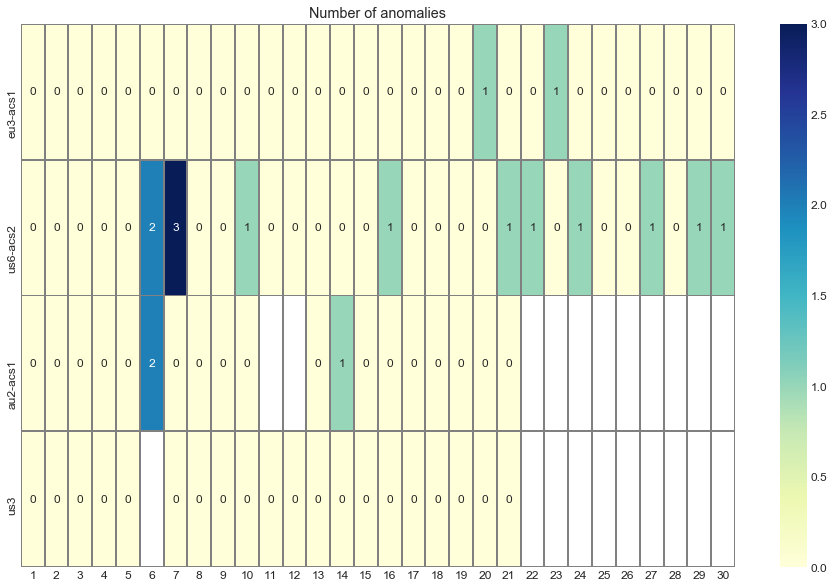

In [15]:
plt.figure(figsize=(16, 10))  
plt.style.use('seaborn-whitegrid')
plt.rcParams.update({'font.size': 12})
sns.heatmap(for_heat_map_number, cmap="YlGnBu", linewidths=1 ,annot=True, linecolor = 'gray',  fmt = "g").set_title('Number of anomalies')

Text(0.5, 1, 'Duration of anomalies')

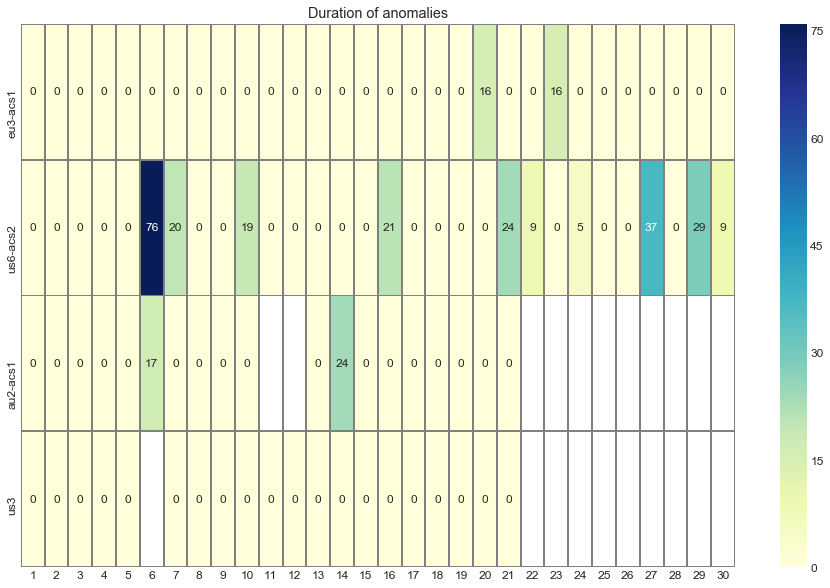

In [16]:
fig, ax = plt.subplots(figsize=(16,10))
plt.style.use('seaborn-whitegrid')
plt.rcParams.update({'font.size': 12})
sns.heatmap(for_heat_map_duration, cmap="YlGnBu", linewidths=1 ,annot=True, linecolor = 'gray', ax = ax, fmt = 'g').set_title('Duration of anomalies')

In [17]:
for_result

,Number of sigmas,Number of anomalies,Expected number of anomalies,Amount of anomaly-time
eu3-acs1,4.4,2,6,32
us6-acs2,5,13,6,249
au2-acs1,2.8,3,4,41
us3,3.4,0,4,0


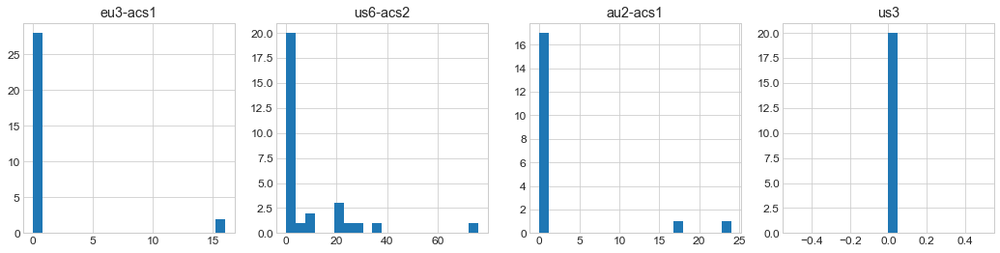

In [18]:
plt.style.use('seaborn-whitegrid')
plt.rcParams.update({'font.size': 12})
plt.rcParams['figure.figsize'] = (18.0, 4.0)
plt.subplot(141)
plt.hist(for_heat_map_duration.iloc[0], bins =20)
plt.title('eu3-acs1') 
plt.subplot(142)
plt.hist(for_heat_map_duration.iloc[1], bins =20)
plt.title('us6-acs2') 
plt.subplot(143)
plt.hist(for_heat_map_duration.iloc[2].dropna(), bins =20)
plt.title('au2-acs1') 
plt.subplot(144)
plt.hist(for_heat_map_duration.iloc[3].dropna(), bins =20)
plt.title('us3') 
plt.show()

In [110]:
def new_var_maker(start_time, finis_time, query_bucket, metric_start, metric_end='_proxied=0', step='1m', data_path=None):
    if data_path is None:
        df = loader.get_normalized_time_series(query=query_bucket,
                                               finish=finis_time,
                                               start=start_time,
                                               step=step
                                               )
    else:
        df = pd.read_csv(data_path)
    df = utils.get_df_with_renamed_col_for_var(df)
    rt = pd.DataFrame.copy(df)
    df.drop(['Unnamed: 0'], axis=1, inplace = True)
    df1 = pd.DataFrame(df[metric_start + '+Inf' + metric_end])
    df1['summ'] = df[metric_start + '+Inf' + metric_end].diff()
    list_of_reloads_indexes = df1[df1['summ']<0].index.tolist()
    list_of_previous_indexes = [i-1 for i in list_of_reloads_indexes]
    df1['summ'].iloc[list_of_reloads_indexes] += df[metric_start + '+Inf' + metric_end].iloc[list_of_previous_indexes]
    

    prevmetric = df[metric_start + str(1) + metric_end]
    # я запихнул массив, который начинается с двойки в переменную ниже
    numbers_2 = conf.get_var_numbers_2()
    for num in numbers_2:
        metric = metric_start + str(num) + metric_end
        df[metric] = df[metric] - prevmetric
        prevmetric = df[metric] + prevmetric
    ts = df['time_stamp']
    del df[metric_start + '+Inf' + metric_end]
   

    # я запихнул массив, который начинается с единицы в переменную ниже
    # я думю нет смысла хранить эти оба массива в Config, лучше понть как правильно работать, используя только один
    numbers_1 = conf.get_var_numbers_1()
    for num in numbers_1:
        metric = metric_start + str(num) + metric_end
        # я пытался убрать это окончаие 'WTF', но ничего не получилось
        # вообще нужно всего две колонки, тактчто их оставлять не обязательно, но процесс должен быть рациональным
        df[metric + 'WTF'] = df[metric].diff()
        df[metric + 'WTF'].iloc[list_of_reloads_indexes] += df[metric].iloc[list_of_previous_indexes]
        del df[metric]

    df = df.drop(df.index[0])
    df['summ'] = df.drop(['time_stamp'], axis=1).sum(axis=1) 
    df['mean'] = df[metric_start + str(1) + metric_end + 'WTF']
    lastnum = 1
    for num in numbers_2:
        metric = metric_start + str(num) + metric_end + 'WTF'
        df['mean'] = df['mean'] + df[metric] * ((num + lastnum) / 2 + 1)
        lastnum = num
    df['mean'] = df['mean'] / df['summ']
    ts = ts.drop(ts.index[0])
    ts = ts.apply(datetime.fromtimestamp)
    df['date'] = ts

    df['variance'] = (1 - df['mean']) ** 2 * df[metric_start + str(1) + metric_end + 'WTF']
    for num in numbers_2:
        metric = metric_start + str(num) + metric_end + 'WTF'
        df['variance'] = df['variance'] + (num - df['mean']) ** 2 * df[metric]
    df['variance'] = df['variance'] / df['summ']
    
    df['99th_percentile'] = 0
    df['95th_percentile'] = 0
    df['90th_percentile'] = 0

    df_copy = pd.DataFrame.copy(df)
    df_copy = df_copy[df_copy.columns[:33]]
    df_copy.dropna(inplace = True)
    ts = df_copy['time_stamp'].values.tolist()

    for t in ts:
            for p in [90, 95, 99]:
                df[str(p)+'th_percentile'][df['time_stamp'].isin([t])] = percentile(df, p, t, numbers_1)
                
    return df

In [112]:
path = '../datasets/for_plot/'
for dc in dict_dc_inst_anomalies: 
    for inst_num in list(dict_dc_inst_anomalies[dc].keys()):
        instance = utils.get_instance_for_dc(dc, inst_num)
        print(f'\nDC = {dc}\nINSTANCE = {inst_num}')
        start_time = dc_period[dc][0]
        end_time = dc_period[dc][1]
        
        st_time = start_time.replace(" ", "").replace("/", "").replace(":", "")
        en_time = end_time.replace(" ", "").replace("/", "").replace(":", "")
        
        out_file_name = 'for_plot/'
        out_file_name += utils.get_file_name(kind=f'simpleLR__train={train_size}__dots={dots}',
                                            dc=dc, inst_num=inst_num, st_time=st_time, en_time=en_time, 
                                            dots=dots)
        
        old_model = '../datasets/for_fitted_model/' + 'simpleLR__train=20160__dots=5__'+dc+'__'+str(inst_num)+'__'+norm_old_model_start_date+'__'+norm_old_model_end_date+'__5.sav'
        
        data_file_name = load_model_data(dc, inst_num, st_time, en_time, dots, pri=False)

        # and data
        data = pd.read_csv(data_file_name)
        data = la_prepro.fill_misses(data)

        predictor = pickle.load(open(old_model, 'rb'))

        out = predictor.predict(data)
        out.dropna(inplace=True)

        out['predictions'] = predictor.scaler_y.inverse_transform(out['predictions_sc'].values.reshape(-1, 1))
        out['target_der'] = predictor.scaler_y.inverse_transform(out['target_der_sc'].values.reshape(-1, 1))

        y_hat = predictor.scaler_y.inverse_transform(out['predictions_sc'].values.reshape((-1, 1)))
        y = predictor.scaler_y.inverse_transform(out['target_der_sc'].values.reshape((-1, 1)))
        out['main_error'] = metrics.relative_mae(y, y_hat, abs_val=True, vectorize=True)

        integrated = utils.get_inegral(init=out['target'].values[0], 
                                       values=out['predictions'].values)[1:]
        out['predicted_target'] = integrated
        # data with variance
        if get_var:
            bucket_query = 'abgw_iop_latency_ms_bucket{dc="' + dc + '"' + ', err="OK", iop="isync", instance="' 
            bucket_query += instance + '", proxied = "0"}'
            metric_start = "abgw_iop_latency_ms_bucket_dc=" + dc + "_err=OK_instance=" + instance
            metric_start += "_iop=isync_job=abgw_le="
            var_file_name = load_var_data(dc, inst_num, st_time, en_time, dots, pri=False)
            df_var = new_var_maker(start_time, end_time, bucket_query, metric_start, data_path=var_file_name)
            out = pd.merge(out, df_var[['time_stamp', 'variance', 'mean', '90th_percentile', '95th_percentile','99th_percentile']], how='outer', on='time_stamp')
        # ну а теперь пожалуй сохраним данные для отчётности
        writer.write_df(df=out, file_name=out_file_name)


DC = us6-acs2
INSTANCE = 10

DC = us6-acs2
INSTANCE = 16

DC = us6-acs2
INSTANCE = 21

DC = us6-acs2
INSTANCE = 22

DC = us6-acs2
INSTANCE = 24

DC = us6-acs2
INSTANCE = 27

DC = us6-acs2
INSTANCE = 29

DC = us6-acs2
INSTANCE = 30

DC = us6-acs2
INSTANCE = 6

DC = us6-acs2
INSTANCE = 7

DC = eu3-acs1
INSTANCE = 20

DC = eu3-acs1
INSTANCE = 23

DC = au2-acs1
INSTANCE = 14

DC = au2-acs1
INSTANCE = 6


# Графики 

In [11]:
def get_plotly_wiht_sep_an(df, columns, list_of_anomalys, dc, inst_num, reloads, mean_an=[], err_an=[]):
    if 'target_der' not in df.columns.values:
        print('hmmmm it seems you are to get new ../datasets/for_plot/...')
        print('the suitable version established on 03.03.2020')
    colors = ['purple', 'pink', 'green', 'gold', 'yellow', 'blue', 'aquamarine']
    fig = make_subplots(rows=5, cols=1)
    number_of_picture_in_subplot = 3
    for column, color in zip(columns, colors):
        spec_group = False

        if column in ['target_der_sc', 'predictions_sc']:
            fig.add_trace(go.Scatter(
                x=df['date'],
                y=df[column],
                line_color=color,
                name=column,
                opacity=0.8), row=1, col=1)
            for rl in reloads:
                fig.add_trace(go.Scatter(
                    x=[datetime.fromtimestamp(rl), datetime.fromtimestamp(rl)],
                    y=[0, max(df['target_der_sc'])],
                    line_color='black',
                    name='reload',
                    opacity=0.8), row=1, col=1)
            spec_group = True

        if column in ['target', 'predicted_target']:
            fig.add_trace(go.Scatter(
                x=df['date'],
                y=df[column],
                line_color=color,
                name=column,
                opacity=0.8), row=2, col=1)
            spec_group = True

        if not spec_group:
            fig.add_trace(go.Scatter(
                x=df['date'],
                y=df[column],
                line_color=color,
                name=column,
                opacity=0.8), row=number_of_picture_in_subplot, col=1)
            number_of_picture_in_subplot += 1
    plot_anomaly(df, list_of_anomalys, fig, row=1)
    plot_anomaly(df, err_an, fig, column='main_error', kind_of_anomaly='error anomaly', row=3)
    plot_anomaly(df, mean_an, fig, column='mean', kind_of_anomaly='mean_latency_anomaly', row=4)
    fig.update_layout(height=1400, width=900, title_text='dc = ' + dc + ' inst_num = ' + str(inst_num))
    # plotly.offline.plot(fig,filename='sampleplot.html')
    return fig


def plot_anomaly(df, list_of_anomaly, fig, column='target_der_sc', kind_of_anomaly='anomaly', row=1):
    i = 0
    for anomaly in list_of_anomaly:
        if i == 0:
            fig.add_trace(go.Scatter(
                x=df['date'].loc[
                  list(df[df['time_stamp'] == anomaly[0]].index)[0]:list(df[df['time_stamp'] == anomaly[1]].index)[0]],
                y=df[column].loc[
                  list(df[df['time_stamp'] == anomaly[0]].index)[0]:list(df[df['time_stamp'] == anomaly[1]].index)[0]],
                line_color='red',
                line_width=3,
                name=kind_of_anomaly,
                opacity=0.9), row=row, col=1)
            i += 1
        else:
            fig.add_trace(go.Scatter(
                x=df['date'].loc[
                  list(df[df['time_stamp'] == anomaly[0]].index)[0]:list(df[df['time_stamp'] == anomaly[1]].index)[0]],
                y=df[column].loc[
                  list(df[df['time_stamp'] == anomaly[0]].index)[0]:list(df[df['time_stamp'] == anomaly[1]].index)[0]],
                line_color='red',
                line_width=3,
                showlegend=False,
                opacity=0.9), row=row, col=1)


def get_percentile(df, columns, list_of_anomalys, dc, inst_num):
    fig = make_subplots(rows=1, cols=1)
    for column in columns:
        fig.add_trace(go.Scatter(
            x=df['date'],
            y=df[column],
            name=column,
            opacity=0.8), row=1, col=1)
    fig.update_layout(height=400, width=900, title_text='dc = ' + dc + ' inst_num = ' + str(inst_num))
    # plotly.offline.plot(fig,filename='sampleplot.html')
    return fig


In [122]:
# path = '../datasets/for_plot_div_by_error/'
# html_path = '../datasets/plots_div_by_error/'
# n_an = []
# for dc in ['au2-acs1']:
#     for file in sorted(dc_file[dc]):
#         print(file)
#         f_s = str(file).split('__')
#         print(f'DC={f_s[3]}\nINST_N={f_s[4]}\n{f_s[2]}\n{f_s[1]}')
#         inst_n = int(f_s[4])
#         dc = f_s[3]
#         # getting data and adding a column with date
#         train_size = int(f_s[1][6:])
#         plot_data = pd.read_csv(path + file).dropna()[train_size + two_week:]
#         reloads_ts = plot_data[plot_data['target_der'] < 0]['time_stamp'].values
#         print(f'reloads time_stamps: {reloads_ts}')
#         # then fit bound before and after reloads
#         plot_data = analyzer.get_df_with_no_reloads(plot_data, reloads_ts, 'predicted_target')
#         plot_data = analyzer.get_df_with_no_reloads(plot_data, reloads_ts, 'target')
#         plot_data = analyzer.get_df_with_droped_reloads(plot_data, reloads_ts, reload_window=60 * 10)

#         plot_data['date'] = plot_data['time_stamp'].apply(lambda x: datetime.fromtimestamp(x))
#         # anomaly stuff
        
        
        
#         error_anomalys = analyzer.find_interval_of_anomaly_with_simple_mode(plot_data, n_s[dc], 
#                                                                             'main_error')
#         mean_anomalys = analyzer.find_interval_of_anomaly_with_simple_mode(plot_data, n_s[dc], 'mean')
#         list_of_anomalys = analyzer.intersection_of_two_lists_of_anomalies(error_anomalys,
#                                                                            mean_anomalys)
#         print(list_of_anomalys)

#         n_an.append(len(list_of_anomalys))
#         # an statistic for anomaly
#         an_len = 0
#         for interval in list_of_anomalys:
#             an_len += interval[1] - interval[0]
#         total_time = max(plot_data['time_stamp'].values) - min(plot_data['time_stamp'].values)
#         print(f'a part of animaly time is {an_len/total_time * 100}%\n')
#         # plotting, RAM-consuming
#         # '''
#         fig = get_plotly_wiht_sep_an(plot_data, ['target_der_sc', 'predictions_sc','main_error', 
#                                               'mean', 'variance', 'predicted_target', 'target'],
#                                   list_of_anomalys, dc, inst_n, reloads_ts, mean_an=mean_anomalys,
#                                   err_an=error_anomalys)
#         plot(fig, filename=f'{html_path}{file}.html', auto_open=False)

#         #and plot there matplotlib plots
#         '''
#         fig, axs = pe_plt.get_ez_ram_plt(plot_data, list_of_anomalys, reloads_ts)
#         plt.show()
#         '''

# Графики в оригинальных и наших переменных 

In [32]:
dcs

['us6-acs2', 'eu3-acs1', 'us3', 'au2-acs1']

In [19]:
path = '../datasets/for_plot/'
n_s = for_result['Number of sigmas'].to_dict()
for dc in ['au2-acs1']: 
    for inst_num in list(dict_dc_inst_anomalies['au2-acs1'].keys()):
        instance = utils.get_instance_for_dc(dc, int(inst_num))
        print(f'\nDC = {dc}\nINSTANCE = {instance}')
        start_time = dc_period[dc][0]
        end_time = dc_period[dc][1]
        
        st_time = start_time#.replace(" ", "").replace("/", "").replace(":", "")
        en_time = end_time#.replace(" ", "").replace("/", "").replace(":", "")

        
        data_file_name = load_model_data(dc, inst_num, st_time, en_time, pri=False)
        data = pd.read_csv(data_file_name)
        data['date'] = data['time_stamp'].apply(lambda x: datetime.fromtimestamp(x))
        
        file = [inst for inst in sorted(dc_file[dc]) if int(inst_num) == int(str(inst).split('__')[4])][0]
        f_s = str(file).split('__')
        train_size = int(f_s[1][6:])
        plot_data = pd.read_csv(path + file).dropna()
        reloads_ts = plot_data[plot_data['target_der'] < 0]['time_stamp'].values
        # then fit bound before and after reloads
        plot_data = analyzer.get_df_with_no_reloads(plot_data, reloads_ts, 'predicted_target')
        plot_data = analyzer.get_df_with_no_reloads(plot_data, reloads_ts, 'target')
        plot_data = analyzer.get_df_with_droped_reloads(plot_data, reloads_ts, reload_window=60 * 10)

        plot_data['date'] = plot_data['time_stamp'].apply(lambda x: datetime.fromtimestamp(x))
        # anomaly stuff
        
        error_anomalys = analyzer.find_interval_of_anomaly_with_simple_mode(plot_data, n_s[dc], 
                                                                            'main_error')
        mean_anomalys = analyzer.find_interval_of_anomaly_with_simple_mode(plot_data, n_s[dc], 'mean')
        list_of_anomalys = analyzer.intersection_of_two_lists_of_anomalies(error_anomalys,
                                                                           mean_anomalys)
        fig = get_percentile(plot_data, ['99th_percentile','95th_percentile','90th_percentile'], list_of_anomalys, dc, inst_num)

        fig.show()
        
        fig = get_plotly_wiht_sep_an(plot_data, ['target_der_sc', 'predictions_sc','main_error', 
                                              'mean', 'variance', 'predicted_target', 'target'],
                                  list_of_anomalys, dc, inst_num, reloads_ts, mean_an=mean_anomalys,
                                  err_an=error_anomalys)
        fig.show()
        
#         for j, anomaly in enumerate(dict_dc_inst_anomalies[dc][inst_num]):
#             ts_intervals = [j for j in data['time_stamp'].values.tolist() if (j >= anomaly[0] - 60*10 and j <= anomaly[1] + 60*10)]
#             an_intervals = [j for j in data['time_stamp'].values.tolist() if (j >= anomaly[0]  and j <= anomaly[1] )]
#             fig = make_subplots(rows = 5 , cols=1)
#             colors = ['purple', 'pink', 'green', 'gold', 'yellow', 'blue']
#             for i, metric in enumerate(dict_dc_inst_metric[dc][inst_num]):
#                 fig.add_trace(go.Scatter(x=data['date'], y=data[metric].diff(), name = metric[4:], marker_color = colors[i]), row = i + 1 , col = 1)
#                 fig.add_trace(go.Scatter(x=data.loc[data['time_stamp'].isin(an_intervals)]['date'], y=data.loc[data['time_stamp'].isin(an_intervals)][metric].diff(), marker_color='red', showlegend=False,), row = i + 1 , col = 1)
#             fig.update_layout(height=1400, width=900, title_text = 'dc = ' + dc + ' inst_n = '+ str(inst_num)+ ' coeff = ' + str(dict_dc_inst_anomalies_coeff[dc][inst_num][j]) , xaxis_title = "Date")
#             fig.show()


DC = au2-acs1
INSTANCE = au2-acs1-stor14.vstoragedomain



DC = au2-acs1
INSTANCE = au2-acs1-stor06.vstoragedomain
